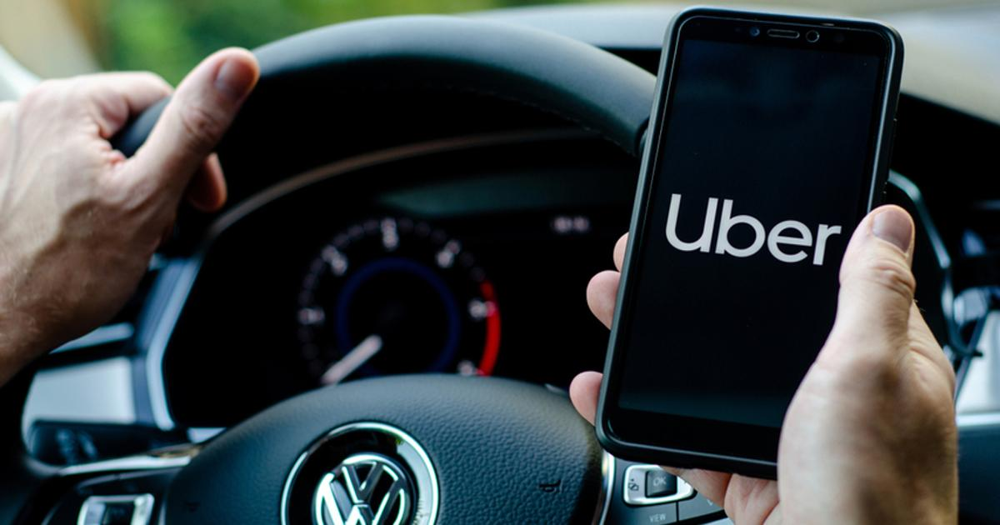

In [1]:
#Import the library 'Pandas'
import pandas as pd

#Import the library 'Numpy'
import numpy as np

#Import the subpackage of Matplotlib for plotting
import matplotlib.pyplot as plt

#Enable inline plotting in Jupyter notebooks
%matplotlib inline

#Import the library 'Seaborn' for statistical plotting
import seaborn as sns

#Import the function 'filterwarnings' from the 'warnings' library to suppress warnings
from warnings import filterwarnings

#Suppress warnings
filterwarnings('ignore')

# Import Cluster Algorithms
from sklearn.cluster import *

#Set options to display all columns and rows of the dataframe
pd.options.display.max_columns = None
pd.options.display.max_rows = None

#Set options to display float values up to 6 decimal places in the dataframe
pd.options.display.float_format = '{:.6f}'.format

#Import the 'datetime' subpackage from the 'datetime' library to manipulate dates and times
from datetime import datetime as dt

# Import the datetime module
import datetime
from datetime import datetime

# Import the defaultdict and OrderedDict classes from the collections module
from collections import defaultdict, OrderedDict

#Import the library 'Folium' for interactive maps
import folium 
from folium.plugins import HeatMap

# Import HeatMapWithTime plugin from folium library
from folium.plugins import HeatMapWithTime

#Create a base map object
base = folium.Map()

#Import the library 'Plotly Express' for interactive plotting
import plotly.express as px

#Set the plot size using 'rcParams'
plt.rcParams['figure.figsize'] = [15,8]

# Overview:


## 1.Business Problem Understanding:
* Uber is an international company located in 69 countries and around 900 cities around the world. 
* However, in the US, it is the second-largest passenger company with a market share of 31%. 
* In the recent years there is a large growth in the movement of people in Cabs/Taxis/uber where the Taxi/uber Platforms  connects people with driver and drops at the location. 
* Assigning the nearest driver to the customer is crucial to decrease the wait time.

## 2.Business Objective
* The project's eventual objective is to forecast the pickup of the cab based on bridging the supply,demand gap, shortening ETA,   and refining the route. So that it is able to Prioritize the Customer 
* Satisfaction and in turn increase revenue of the company. 

## 3.Approach
* Considering the size of the dataset, the data that was analyzed and given to the company was 
  found to be unproductive and ineffective based on the issues with forecasting failures.
* Thus, in order to solve the issue, we will forecast where the cab will be picked up from a coordinated 
  cluster of sites utilizing the proposed k-means clustering technique. Plus, by Utilizing multiple 
  EDA and statistics for ML approaches to investigate NYC Uber trips. Depending on how much 
  data we have and features, the analysis can go on and on.

Uber trip data from 2014
There are six files of raw data on Uber pickups in New York City from April to September 2014. The files are separated by month and each has the following columns:

* Date/Time : The date and time of the Uber pickup
* Lat : The latitude of the Uber pickup
* Lon : The longitude of the Uber pickup
* Base : The TLC(Taxi & Limousine Commission) base company code affiliated with the Uber pickup
    
The New York City Taxi and Limousine Commission (TLC) is a government agency that regulates and licenses the taxi and for-hire vehicle industries in New York City. The TLC's primary responsibilities include:
Issuing and renewing licenses for taxi and for-hire vehicle drivers, owners, and vehicles
Setting rules and standards for the operation of taxis and for-hire vehicles, including requirements for vehicle safety, insurance, and customer service
Enforcing TLC rules and regulations through inspections, investigations, and penalties
Collecting and publishing data on the taxi and for-hire vehicle industries
The TLC operates a call center and website to handle inquiries and complaints from the public, and it also holds public meetings to solicit input from stakeholders on issues related to the taxi and for-hire vehicle industries.


In the context of the New York City Taxi and Limousine Commission (TLC), a base is a licensed entity that dispatches for-hire vehicles (FHVs) such as black cars, luxury limousines, and app-based ride-hail services like Uber. The TLC assigns each base company a unique code that identifies it in TLC records.

Each base is responsible for maintaining a list of affiliated drivers and vehicles, and for ensuring that these drivers and vehicles meet the TLC's licensing and safety requirements. When a rider requests a ride through the Uber app, for example, the request is sent to a nearby Uber driver who is affiliated with an Uber base. The base is responsible for dispatching the driver to pick up the rider and complete the trip.

In [2]:
#Read the 'uber-raw-data-apr14.csv' file into a dataframe 'df1'
df1 = pd.read_csv('C:\\Users\\prith\\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-apr14.csv')

#Read the 'uber-raw-data-may14.csv' file into a dataframe 'df2'
df2 = pd.read_csv('C:\\Users\\prith\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-may14.csv')

#Read the 'uber-raw-data-jun14.csv' file into a dataframe 'df3'
df3 = pd.read_csv('C:\\Users\\prith\\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-jun14.csv')

#Read the 'uber-raw-data-jul14.csv' file into a dataframe 'df4'
df4 = pd.read_csv('C:\\Users\\prith\\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-jul14.csv')

#Read the 'uber-raw-data-aug14.csv' file into a dataframe 'df5'
df5 = pd.read_csv('C:\\Users\\prith\\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-aug14.csv')

#Read the 'uber-raw-data-sep14.csv' file into a dataframe 'df6'
df6 = pd.read_csv('C:\\Users\\prith\\Videos\\DS\\CAPSTONE\\Capstone - Final Submission\\Uber-dataset\\uber-raw-data-sep14.csv')

In [3]:
# Concatenate the dataframes
frames = [df1, df2, df3, df4, df5, df6]
df = pd.concat(frames)

In [4]:
# Display first five observations using head()
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.769000,-73.954900,B02512
1,4/1/2014 0:17:00,40.726700,-74.034500,B02512
2,4/1/2014 0:21:00,40.731600,-73.987300,B02512
3,4/1/2014 0:28:00,40.758800,-73.977600,B02512
4,4/1/2014 0:33:00,40.759400,-73.972200,B02512


In [5]:
# To check the dimension of data
df.shape

(4534327, 4)

In [6]:
# To understand the dataset
# Provides information about each column dataFrame, such as data type,number of non-null values, and memory usage.
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


In [7]:
# No of Observations ==> 45,34,327
# No of Columns ==> 4
# No of numeric column ==> 2
# No of categorical column ==> 2

In [8]:
# Statistical summary of the numeric data
df.describe()

,Lat,Lon
count,4534327.000000,4534327.000000
mean,40.739261,-73.973019
std,0.039950,0.057267
min,39.656900,-74.929000
25%,40.721100,-73.996500
50%,40.742200,-73.983400
75%,40.761000,-73.965300
max,42.116600,-72.066600


In [9]:
# Statistical summary of the categorical data
df.describe(exclude=np.number)

,Date/Time,Base
count,4534327,4534327
unique,260093,5
top,4/7/2014 20:21:00,B02617
freq,97,1458853


In [10]:
# No of null rows present
df.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [11]:
# Convert 'Date/Time' column to datetime format
# This line of code converts the 'Date/Time' column in the dataFrame to a datetime data type, using the specified format.
df['Date/Time'] = pd.to_datetime(df['Date/Time'],format="%m/%d/%Y %H:%M:%S")
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512


In [12]:
# Divide the Date/Time column into 15 minute bins
# The minute attribute of the Date/Time column is extracted and divided by 15, 
# then rounded down to the nearest multiple of 15 
# using integer division (// 15) to create the Binned_time column
df['Binned_time'] = df['Date/Time'].dt.minute // 15 * 15
df.head()

,Date/Time,Lat,Lon,Base,Binned_time
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30


In [13]:
# Extracting the day in week (numeric) from the Date/Time
df['DayOfWeekNum'] = df['Date/Time'].dt.dayofweek
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1


In [14]:
# Extracting the month from the Date/Time
df['month'] = df['Date/Time'].dt.month_name()
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April


In [15]:
# Extracting the day from the Date/Time
df['MonthDayNum'] = df['Date/Time'].dt.day
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1


In [16]:
# Extracting the Hour from the Date/Time
df['HourOfDay'] = df['Date/Time'].dt.hour
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum,HourOfDay
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1,0
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1,0
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1,0
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1,0
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1,0


In [17]:
# Extracting the Date from the Date/Time
df['Date'] = df['Date/Time'].dt.date
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum,HourOfDay,Date
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1,0,2014-04-01
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1,0,2014-04-01
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1,0,2014-04-01
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1,0,2014-04-01
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1,0,2014-04-01


In [18]:
# Extracting the day of week(numeric) from the Date/Time
df['DayofWeek'] = df['Date/Time'].dt.weekday   #(Monday is 0, Sunday is 6)
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum,HourOfDay,Date,DayofWeek
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1,0,2014-04-01,1
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1,0,2014-04-01,1
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1,0,2014-04-01,1
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1,0,2014-04-01,1
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1,0,2014-04-01,1


In [19]:
# Extracting the day of week(name) from the Date/Time
df['Day_Name'] = df['Date/Time'].dt.day_name()
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum,HourOfDay,Date,DayofWeek,Day_Name
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1,0,2014-04-01,1,Tuesday
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1,0,2014-04-01,1,Tuesday
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1,0,2014-04-01,1,Tuesday
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1,0,2014-04-01,1,Tuesday
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1,0,2014-04-01,1,Tuesday


In [20]:
# Extracting the Minute from the Date/Time
df['Minute'] = df['Date/Time'].dt.minute
df.head()

,Date/Time,Lat,Lon,Base,Binned_time,DayOfWeekNum,month,MonthDayNum,HourOfDay,Date,DayofWeek,Day_Name,Minute
0,2014-04-01 00:11:00,40.769000,-73.954900,B02512,0,1,April,1,0,2014-04-01,1,Tuesday,11
1,2014-04-01 00:17:00,40.726700,-74.034500,B02512,15,1,April,1,0,2014-04-01,1,Tuesday,17
2,2014-04-01 00:21:00,40.731600,-73.987300,B02512,15,1,April,1,0,2014-04-01,1,Tuesday,21
3,2014-04-01 00:28:00,40.758800,-73.977600,B02512,15,1,April,1,0,2014-04-01,1,Tuesday,28
4,2014-04-01 00:33:00,40.759400,-73.972200,B02512,30,1,April,1,0,2014-04-01,1,Tuesday,33


In [21]:
# Lets convert all the newly created columns into object so that we can use it as a discrete variable

In [22]:
df['month'] = df['month'].astype(object)
df['HourOfDay'] = df['HourOfDay'].astype(object)
df['DayOfWeek'] = df['DayofWeek'].astype(object)
df['MonthDayNum'] = df['MonthDayNum'].astype(object)

In [23]:
# Lets get some inference from the data
df.describe(exclude=np.number)

,Date/Time,Base,month,MonthDayNum,HourOfDay,Date,Day_Name,DayOfWeek
count,4534327,4534327,4534327,4534327.000000,4534327.000000,4534327,4534327,4534327.000000
unique,260093,5,6,31.000000,24.000000,183,7,7.000000
top,2014-04-07 20:21:00,B02617,September,30.000000,17.000000,2014-09-13,Thursday,3.000000
freq,97,1458853,1028136,167160.000000,336190.000000,43205,755145,755145.000000
first,2014-04-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2014-09-30 22:59:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
# 2014-04-07 20:21:00 Date/Time is when we picked 97 customers simulataneously at the same time (from april to september)
# B02617 is the base from which the cabs picked most of the riders , ie (around 14 lakhs Pick-ups) (from april to september)
# On September 2014 , In total of 10 lakhs riders has been provided a ride (from april to september)
# The Busiest hour on a day is around 17.00 PM . On this hour We picked 3.36 lakhs riders (from april to september)
# From april to september,on a particular date (2014-09-13 00:00:00 (Saturday)), we successfully completed 43205 rides which is the highest number rides picked on a single day!!!
# From april to september, Thrusday is the most busiest day on a week, around 7.5 lakhs 
# Over a month, on average the day 30th is when the more number trips has been successfully completed, around 1.6 lakhs

In [25]:
# Calculate the percentage of total trips for each month
(df['month'].value_counts(normalize=True)*100)

September   22.674501
August      18.288822
July        17.557644
June        14.640409
May         14.388795
April       12.449830
Name: month, dtype: float64

In [26]:
# Calculate the percentage of total trips for each base
(df['Base'].value_counts(normalize=True)*100)

B02617   32.173529
B02598   30.723699
B02682   26.746836
B02764    5.820026
B02512    4.535910
Name: Base, dtype: float64

In [27]:
# Calculate the percentage of total trips for each hour in a day . 
df.HourOfDay.value_counts(normalize=True)*100

17   7.414331
18   7.160467
16   6.911720
19   6.495187
20   6.276654
21   6.207316
15   6.075124
22   5.333934
14   5.086201
13   4.319869
7    4.258493
8    4.201373
12   3.759147
23   3.731314
11   3.654412
9    3.527911
10   3.509848
6    3.158418
0    2.289998
5    1.851190
1    1.482624
4    1.218042
3    1.064921
2    1.011506
Name: HourOfDay, dtype: float64

In [28]:
# Calculate the percentage of total trips for each Day in a week
df.month.value_counts(normalize=True)*100

September   22.674501
August      18.288822
July        17.557644
June        14.640409
May         14.388795
April       12.449830
Name: month, dtype: float64

In [29]:
# Calculate the percentage of total trips for each Day in a week
df['DayOfWeek'].value_counts(normalize=True)*100

3   16.653960
4   16.345072
2   15.360339
1   14.639196
5   14.249391
0   11.941618
6   10.810425
Name: DayOfWeek, dtype: float64

In [30]:
# Calculate the percentage of total trips for each Day in a month
df['MonthDayNum'].value_counts(normalize=True)*100

30   3.686545
12   3.542003
16   3.504842
13   3.460095
23   3.441128
9    3.421346
15   3.390272
26   3.383192
19   3.376201
25   3.366916
17   3.363763
10   3.363233
18   3.337188
29   3.287941
11   3.282957
5    3.243127
22   3.240878
8    3.219530
27   3.212208
20   3.179722
24   3.179502
7    3.164814
2    3.158153
3    3.153346
28   3.113075
21   3.112083
4    3.107914
14   3.090823
6    3.085044
1    2.810340
31   1.721821
Name: MonthDayNum, dtype: float64

In [31]:
# Compute cross tabulation of the frequency of rides for each Base and each DayOfWeek
pd.crosstab(df['DayOfWeek'],df['Base'],values=df['Base'],aggfunc='count')

Base,B02512,B02598,B02617,B02682,B02764
DayOfWeek,,,,,
0,25460,163542,176416,143372,32682
1,31670,202378,214167,176198,39376
2,32929,216644,222669,189863,34383
3,35032,235157,240216,205091,39649
4,33319,229908,234379,201594,41939
5,26773,198832,206554,170160,43795
6,20490,146652,164452,126511,32075


In [32]:
# Compute the mean frequency of rides for each Base and each DayOfWeek
pd.crosstab(df['DayOfWeek'],df['Base'],values=df['Base'],aggfunc='count').mean()

Base
B02512    29381.857143
B02598   199016.142857
B02617   208407.571429
B02682   173255.571429
B02764    37699.857143
dtype: float64

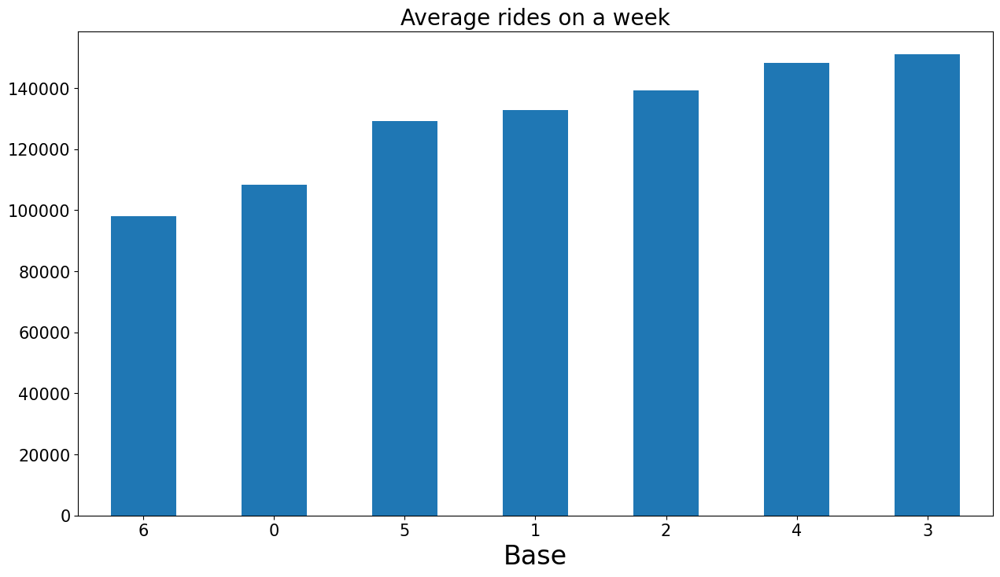

In [33]:
# Plot the mean frequency of rides for each Base across different days of the week as a bar graph
pd.crosstab(df['Base'],df['DayOfWeek'],values=df['Base'],aggfunc='count').mean().sort_values().plot(kind = 'bar')
# Customize the x-axis labels and font size for the bar graph
plt.xticks(rotation = 0,fontsize = 15)
plt.xlabel(xlabel = 'Base' , fontsize = 24)
plt.yticks(fontsize = 15)
plt.title('Average rides on a week',fontsize = 20)
plt.show()

In [34]:
# Missing Value Analysis
# sorting the variables on the basis of total null values in the variable
# 'isnull().sum()' returns the number of missing values in each variable
# 'ascending = False' sorts values in the descending order
# the variable with highest number of missing values will appear first
Total = df.isnull().sum().sort_values(ascending=False)          

In [35]:
# calculate percentage of missing values
# 'ascending = False' sorts values in the descending order
# the variable with highest percentage of missing values will appear first
Percent = (df.isnull().sum()*100/df.isnull().count()).sort_values(ascending=False)   

In [36]:
# concat the 'Total' and 'Percent' columns using 'concat' function
# pass a list of column names in parameter 'keys' 
# 'axis = 1' concats along the columns
missing_data = pd.concat([Total, Percent], axis=1, keys=['Total', 'Percentage of Missing Values'])    
missing_data

,Total,Percentage of Missing Values
Date/Time,0,0.000000
Lat,0,0.000000
Lon,0,0.000000
Base,0,0.000000
Binned_time,0,0.000000
DayOfWeekNum,0,0.000000
month,0,0.000000
MonthDayNum,0,0.000000
HourOfDay,0,0.000000
Date,0,0.000000


# EDA :

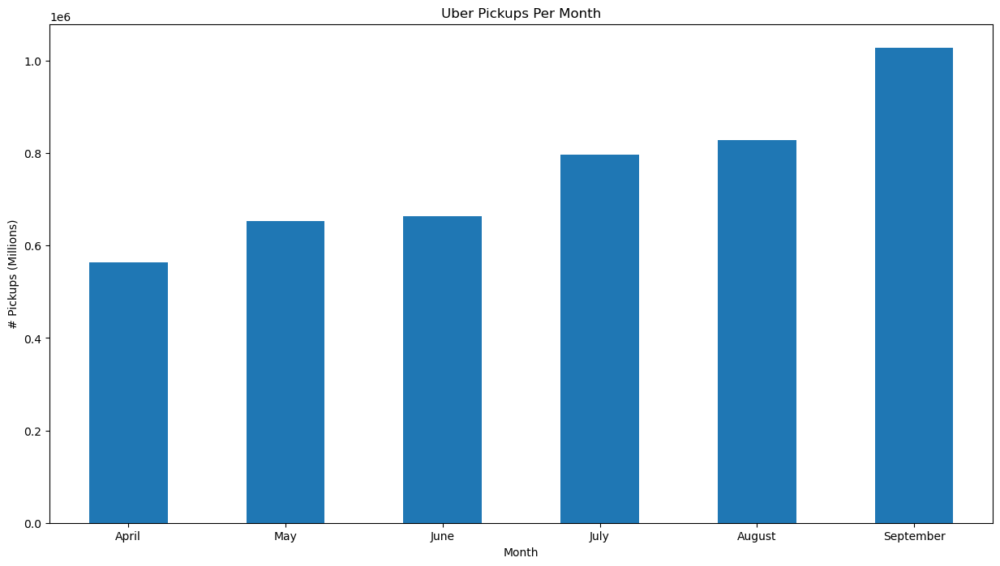

In [37]:

# Create a new dataframe 'uber_monthly_pickups' that counts the number of pickups by month
uber_monthly_pickups = df['month'].value_counts(ascending=True)

# Plot the data in the dataframe as a bar chart
uber_monthly_pickups.plot(kind='bar', rot=0)

# title to the chart
plt.title('Uber Pickups Per Month')

# label for the x-axis
plt.xlabel('Month')

# label for the y-axis
plt.ylabel('# Pickups (Millions)')

# Show the chart
plt.show()


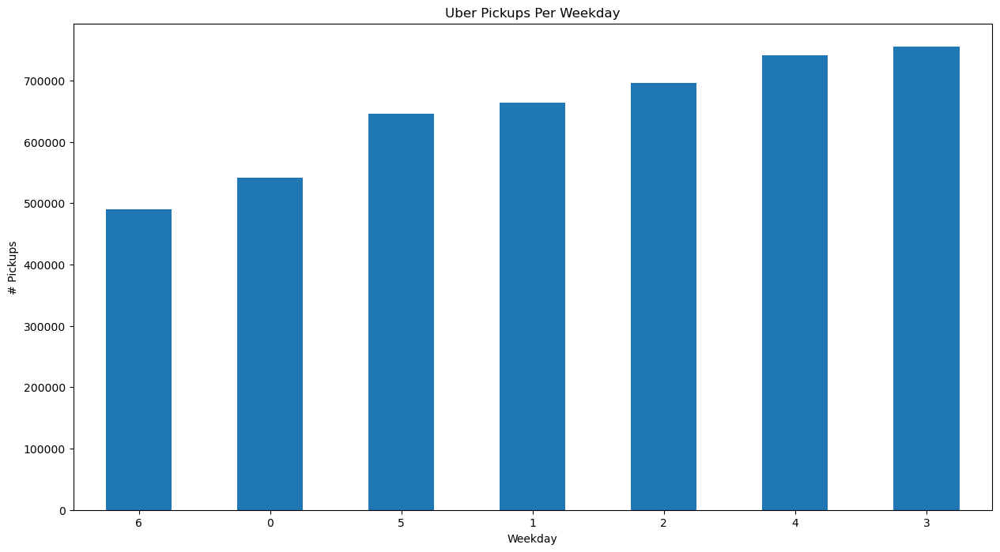

In [38]:
# Count the number of pickups for each day of the week
uber_pickups = df['DayOfWeek'].value_counts(ascending=True)

# Plot the number of pickups as a bar chart, with the days of the week on the x-axis
# and the number of pickups on the y-axis
uber_pickups.plot(kind='bar', rot=0)

# Add a title to the plot
plt.title('Uber Pickups Per Weekday')

# Label the x-axis with "Weekday"
plt.xlabel('Weekday')

# Label the y-axis with "# Pickups"
plt.ylabel('# Pickups')


# Show the chart
plt.show()


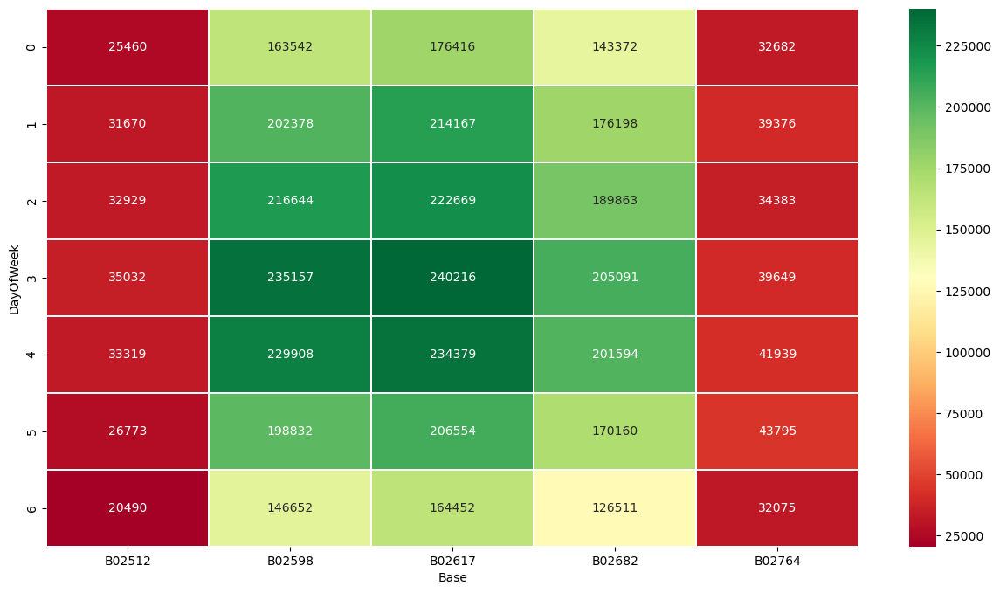

In [39]:
# Create a new dataframe "uber_days_base" with the cross-tabulation of the "DayOfWeek" and "Base" columns from the original dataframe "df"
uber_days_base = pd.crosstab(df['DayOfWeek'], df['Base'])

# Create a heatmap using the "uber_days_base" dataframe with the "annot" parameter set to True for annotations, 
# "fmt" set to an empty string for no formatting, "cmap" set to 'RdYlGn' for a red-yellow-green color map, and
# "linewidths" set to 0.30 for the width of the line around each cell
sns.heatmap(uber_days_base, annot=True, fmt="d", cmap='RdYlGn', linewidths=0.30)

# Show the plot
plt.show()

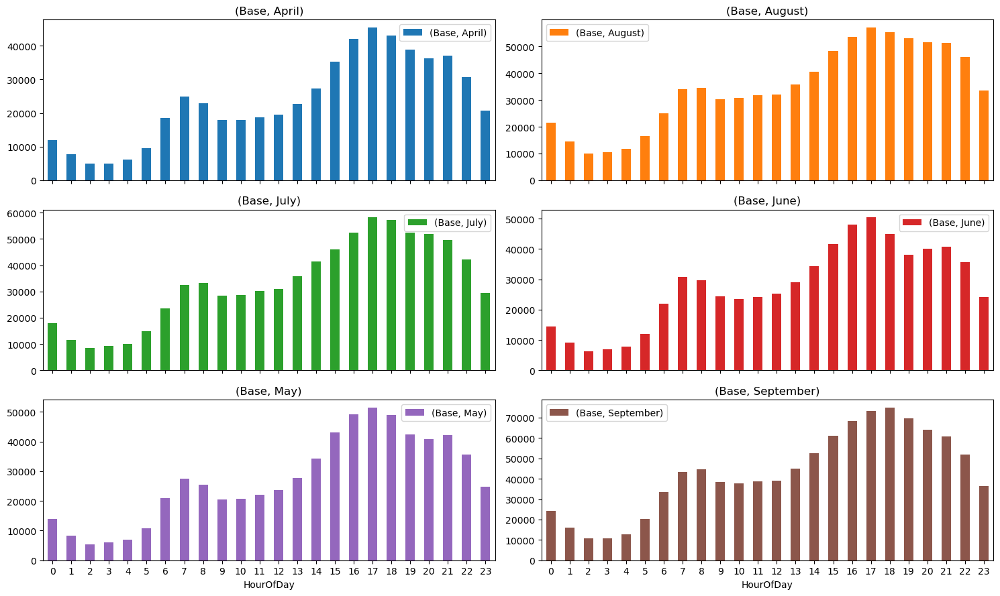

In [40]:
# Plotting pivot table for counts of Base values grouped by hour and month
uber_hour = df.pivot_table(index=['month', 'HourOfDay'], values='Base', aggfunc='count')
# Unstacking pivot table and plotting as subplots with rot=0, figsize=(15,9), layout=(3, 2)
ax = uber_hour.unstack(level=0).plot(kind='bar', subplots=True, rot=0, figsize=(15,9), layout=(3, 2))
plt.tight_layout()

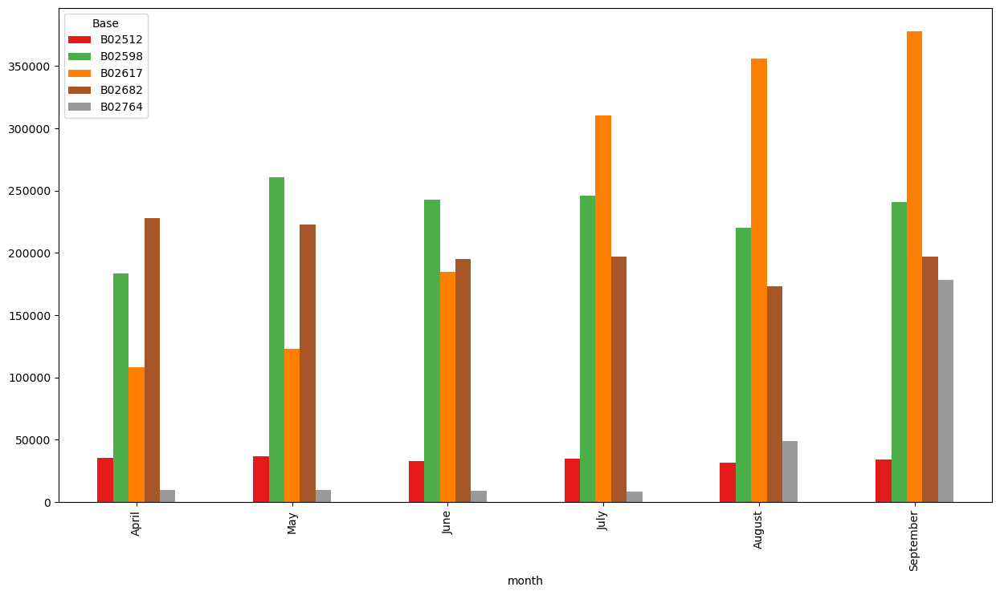

In [41]:
# Cross-tabulation of the 'Base' and 'Month' columns
cross_tab = pd.crosstab(columns=df['Base'],index=df['month']).loc[['April','May','June','July','August','September']]

# Plot the cross-tabulation as a bar graph using the 'Set1' colormap
cross_tab.plot(kind='bar',colormap='Set1')

# Display the plot
plt.show()

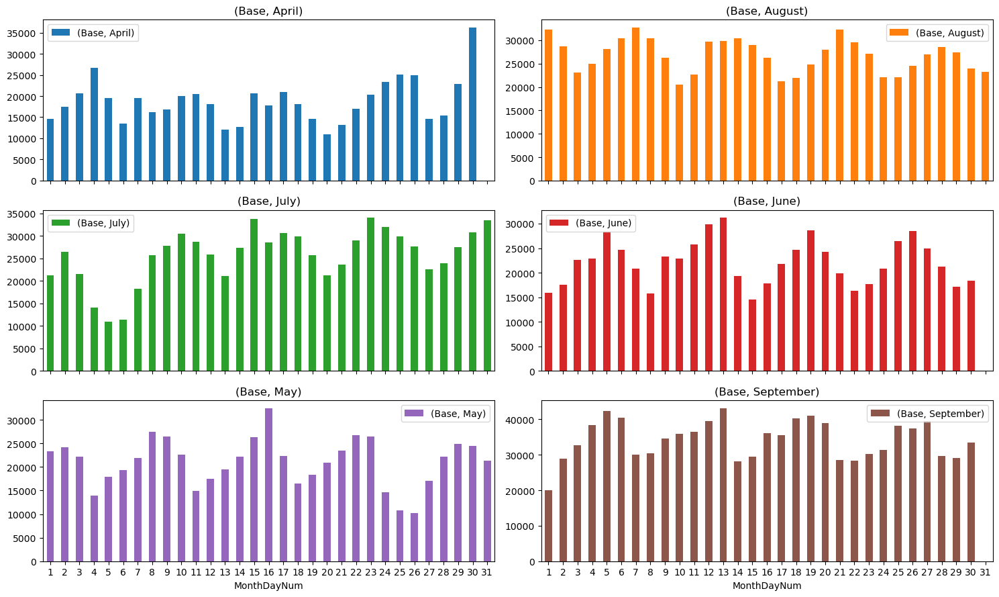

In [42]:
#Create a pivot table of total trips by day and month
uber_totaldays = df.pivot_table(index=['month','MonthDayNum'],  
                                 values='Base',  
                                 aggfunc='count')

#Plot the pivot table as a bar chart with subplots
ax = uber_totaldays.unstack(level=0).plot(kind='bar', 
                                           subplots=True, 
                                           rot=0, 
                                           figsize=(15,9), 
                                           layout=(3, 2))

#Adjust the layout of the subplots to fit the figure
plt.tight_layout()


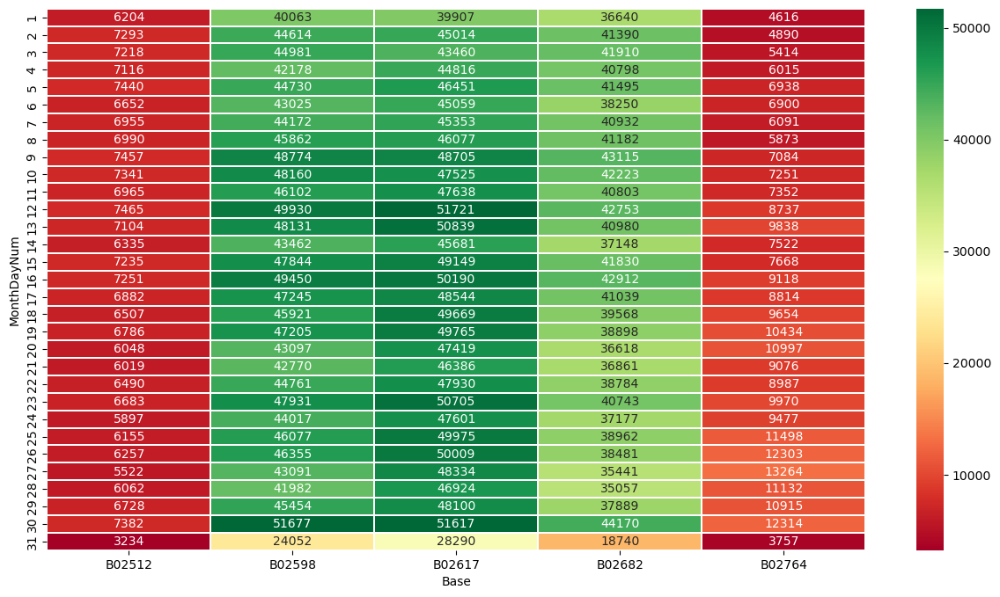

In [43]:
# cross-tabulation of the MonthDayNum and Base columns in the dataframe
uber_totaldays_base = pd.crosstab(df['MonthDayNum'], df['Base'])

# heatmap using the cross-tabulated data and set the color map to 'RdYlGn'
sns.heatmap(uber_totaldays_base, annot=True, fmt="d", cmap='RdYlGn', linewidths=0.30)

# Show the heatmap
plt.show()

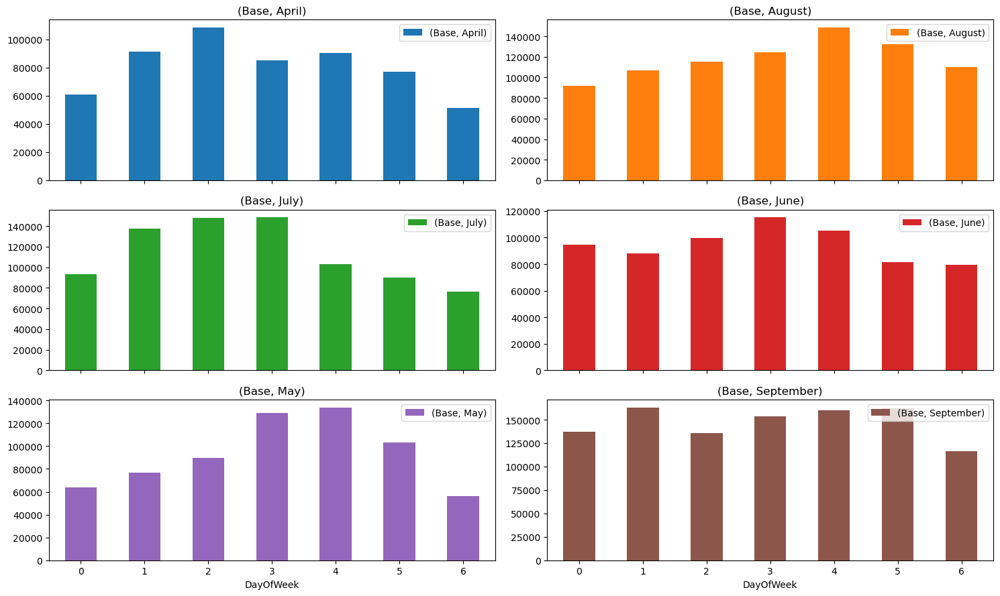

In [44]:
# pivot table with index being the combination of "month" and "DayOfWeek", and value being "Base"
uber_days = df.pivot_table(index=['month','DayOfWeek'], values='Base', aggfunc='count')

# Plot the pivot table as a bar plot, unstacked by level 0 (i.e. "month")
# Use subplots for each month, with 3 rows and 2 columns
# Rotate x-axis labels by 0 degrees
# Set the figure size to (15, 9)
# Set the layout to (3, 2)
ax = uber_days.unstack(level=0).plot(kind='bar', subplots=True, rot=0, figsize=(15,9), layout=(3, 2))

# Adjust the layout to make the plot more readable
plt.tight_layout()


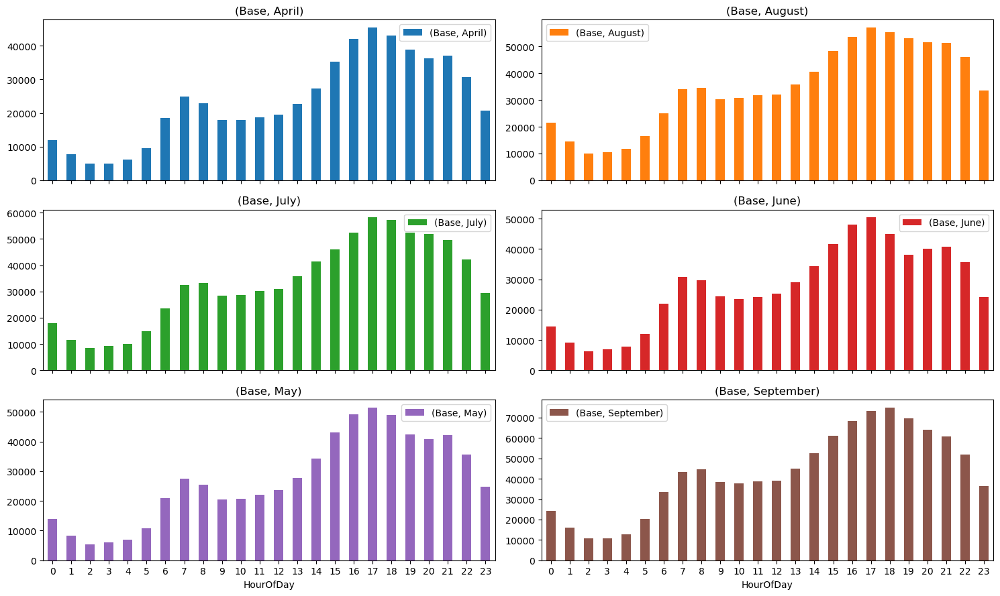

In [45]:
# Plotting pivot table for counts of Base values grouped by hour and month
uber_hour = df.pivot_table(index=['month', 'HourOfDay'], values='Base', aggfunc='count')
# Unstacking pivot table and plotting as subplots with rot=0, figsize=(15,9), layout=(3, 2)
ax = uber_hour.unstack(level=0).plot(kind='bar', subplots=True, rot=0, figsize=(15,9), layout=(3, 2))
plt.tight_layout()

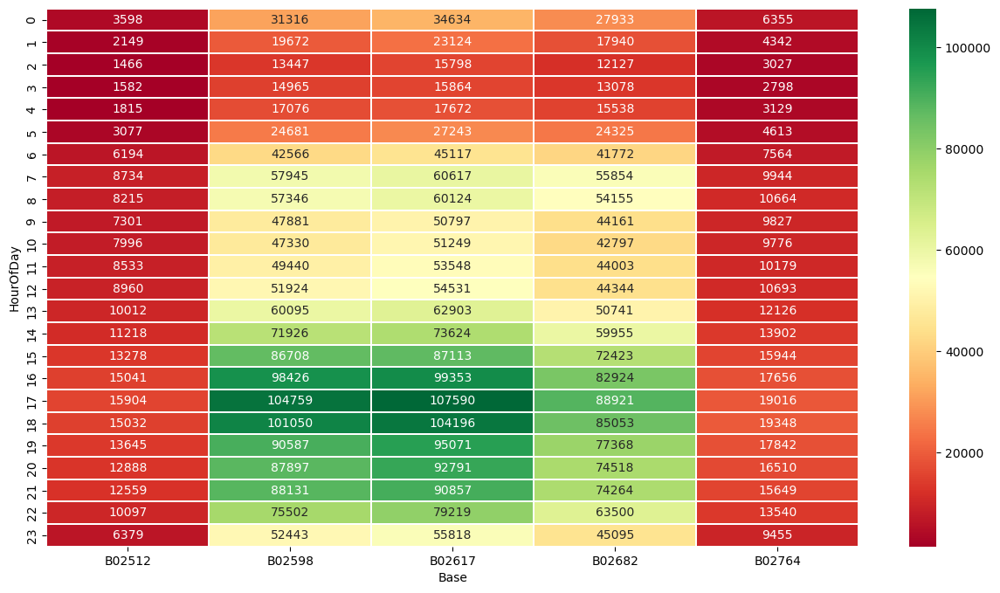

In [46]:
# Plotting heatmap for cross tabulated data of HourOfDay and Base
uber_hour_base = pd.crosstab(df['HourOfDay'], df['Base'])
# Create a heatmap using the cross-tabulated data and set the color map to 'RdYlGn'
sns.heatmap(uber_hour_base, annot=True, fmt="d", cmap='RdYlGn', linewidths=0.30)
# Show the heatmap
plt.show()

In [47]:
# Creating a dataframe of count of values of Base grouped by MonthDayNum and month
DayOfWeek = pd.DataFrame(df[['MonthDayNum', 'month']].value_counts()).reset_index()
DayOfWeek.columns = ['MonthDayNum', 'Month', 'Count']
# Categorizing MonthDayNum with categories [1, 2, ..., 31] in order
DayOfWeek['MonthDayNum'] = pd.Categorical(DayOfWeek['MonthDayNum'], categories=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], ordered=True)
# Categorizing Month with categories ['April', 'May', 'June', ..., 'September'] in order
DayOfWeek['Month'] = pd.Categorical(DayOfWeek['Month'], categories=['April', 'May', 'June', 'July', 'August', 'September'], ordered=True)

In [48]:
# bar plot of the number of trips by day and month using Plotly Express
best_day = px.bar(DayOfWeek,
      # Specify the x-axis data as 'MonthDayNum'
      x='MonthDayNum',
      # Specify the y-axis data as 'Count'
      y='Count',
      # Add a color dimension to the plot using the 'Month' column
      color='Month',
      # Use the 'plotly_dark' template for the plot
      template='plotly_dark',
      # Label the y-axis as 'Number of Trips' and the x-axis as 'MonthDayNum'
      labels={'Count':'Number of Trips','Day':'MonthDayNum'},
      # Set the width of the plot to 1000
      width=1000,
      # Set the height of the plot to 500
      height=500,
      # Order the categories of the 'Month' dimension in the order ['April','May','June','July','August','September']
      category_orders={"Month": ['April','May','June','July','August','September']},
      # Add text labels to the bars using the 'Count' column
      text='Count')

# Update the text labels on the plot to include only 2 decimal places and display outside of the bars
best_day.update_traces(texttemplate='%{text:.2s}', textposition='outside')

# Update the uniform text settings to have a minimum size of 8 and to hide text that is too small
best_day.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

# title to the plot, with the title text centered
best_day.update_layout(title_text='Uber trip by Months and Days', title_x=0.5)

# Show the plot
best_day.show()


In [49]:
# dataframe with HourOfDay column as index and Count column as the number of trips at each hour
HourOfDay = pd.DataFrame(df['HourOfDay'].value_counts()).reset_index()

# Rename the columns in the dataframe
HourOfDay.columns = ['HourOfDay','Count']

# Sort the dataframe by HourOfDay
HourOfDay = HourOfDay.sort_values(by='HourOfDay')

# Create a bar graph using Plotly Express with HourOfDay dataframe as the data source
best_hour = px.bar(HourOfDay,
      x='HourOfDay',
      y='Count',
      # Set the template style to 'plotly_dark'
      template='plotly_dark',
      # Labels for the x and y axis
      labels={'Count':'Number of Trips'},
      # Height and width of the plot
      height=500,
      width=1100,
      # Add the count value as text to each bar
      text='Count'
      )

# Update the text of the bars to display only 2 significant figures
best_hour.update_traces(texttemplate='%{text:.2s}', textposition='outside')

# Update the layout to set a minimum font size for text and hide any text that does not fit
best_hour.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

# Update the plot title and set the x position of the title
best_hour.update_layout(title_text='Uber trip by Hours', title_x=0.5)

# Show the plot
best_hour.show()


In [50]:
# new dataframe called `uber_map` by grouping the original dataframe `df` by Latitude and Longitude, and counting the number of trips at each Latitude/Longitude combination
uber_map=(df.groupby(['Lat','Lon']).count()['Date/Time']).reset_index()

# Rename the columns of `uber_map`
uber_map.columns=['Latitude','Longitude','Number of Trips']

# heatmap of the Latitude/Longitude locations and the number of trips at each location
HeatMap(uber_map,zoom=2500,radius=15).add_to(base)

# Display the heatmap on the base map
base


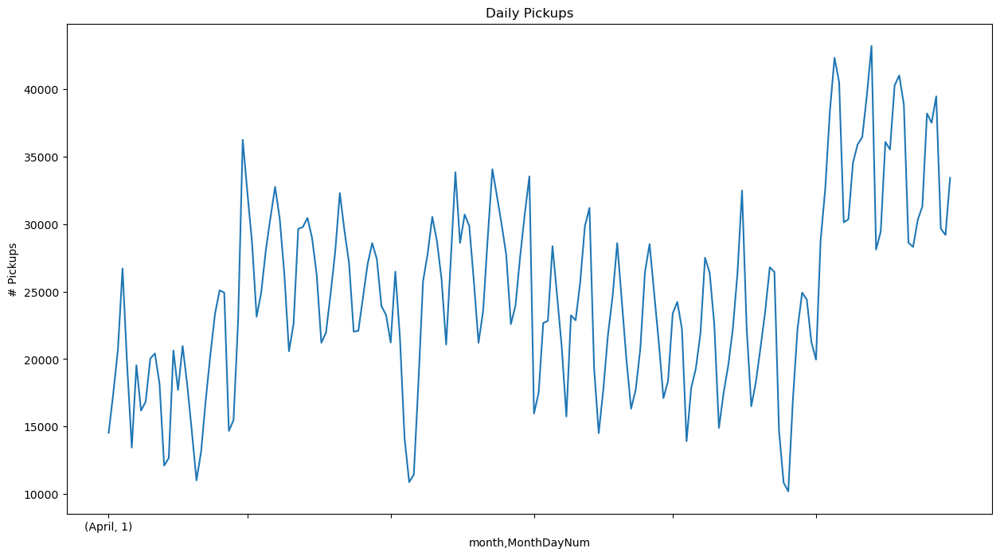

In [51]:
# Group the data by month and day of the month and count the number of pickups
daily_pickups = df.groupby(['month', 'MonthDayNum'])['HourOfDay'].count()

# Plot the count of pickups as a line chart
daily_pickups.plot(kind='line', rot=0)

# Get the location of the first day of each month in the chart
month_starts = np.where(daily_pickups.reset_index(level=0).index.get_loc(1))[0]

# Set the x-axis tick marks to correspond to the first day of each month
plt.xticks(ticks=month_starts)

# Label the y-axis
plt.ylabel('# Pickups')

# Add a title to the chart
plt.title('Daily Pickups')

# Display the plot
plt.show()

In [52]:
# Group the data by Latitude and Longitude columns
lat_lon = df.groupby(['Lat','Lon'],as_index=False).size().sort_values(by = 'size',ascending=False)

# Get the top 100 hot spots with the highest number of trips
hot_spots = lat_lon[['Lat','Lon']].values.tolist()[0:100]

# Create a folium map object with the average latitude and longitude of the data as the center
hs = folium.Map(location=[df.Lat.mean(), df.Lon.mean()],zoom_start=6,control_scale=True)

# Loop through the hot spots list and add markers to the map object for each hot spot
for i in range(len(hot_spots)):
    folium.Marker(location=hot_spots[i],zoom_start=200).add_to(hs)

# Show the map object
hs


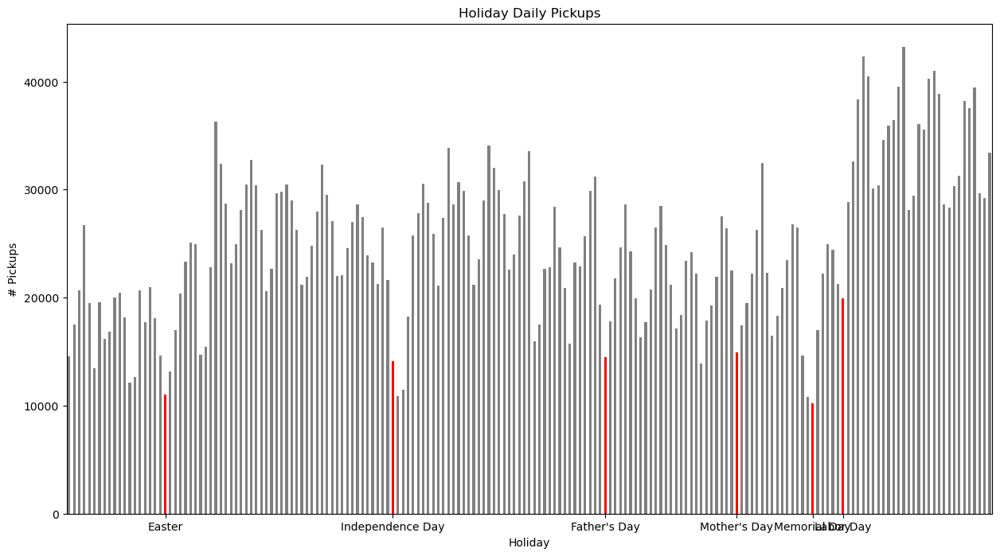

In [53]:
# Define the holiday dates and their corresponding names as a dictionary
holidays = {
    "Easter": ('April', 20), # Sunday
    "Mother's Day": ('May', 11), # Sunday
    "Memorial Day": ('May', 26), # Monday
    "Father's Day": ('June', 15), # Sunday
    "Independence Day": ('July', 4), # Friday
    "Labor Day": ('September', 1) # Monday
}

# Get the indices of the holidays in the daily_pickups data
holiday_starts = [daily_pickups.index.get_loc(hol) for hol in holidays.values()]

# Create a list of colors for the bar plot, marking the holiday bars with red
colors = ['grey' if x not in holiday_starts else 'red' for x in range(len(daily_pickups))]

# Plot the daily_pickups data as a bar plot with the holiday bars colored red
daily_pickups.plot(kind='bar', color=colors, rot=0)

# Set the x-axis labels to be the holiday names
plt.xticks(ticks=holiday_starts, labels=holidays.keys())

# Label the x-axis as "Holiday"
plt.xlabel('Holiday')

# Label the y-axis as "# Pickups"
plt.ylabel('# Pickups')

# Add a title to the plot
plt.title('Holiday Daily Pickups')

plt.show()

* Now, a simple conclusion from this would be that individuals don't use Uber as frequently during holidays. 
* However, something else to consider is the availability of Uber drivers during holidays. 
* Given that Uber drivers set their own work schedules, some may choose to not work during holidays.
* For such a case, a decline in Uber pickups during holidays may not be due to lack of demand but instead due to a lack of available Uber drivers. 
* Additionally, many businesses are closed during holidays so individuals may just have no place to go!

In [54]:
# Group data by month and day of month
daily_pickups = df.groupby(['month', 'MonthDayNum'])['HourOfDay'].count()

# Get the busiest day and the number of pickups on that day
busiest_day = daily_pickups.idxmax()
number_of_pickups = daily_pickups.max()

# Print the busiest day and the number of pickups on that day
print('Busiest Day: {}'.format(busiest_day))
print('Number of pickups: {}'.format(number_of_pickups))

Busiest Day: ('September', 13)
Number of pickups: 43205


In [55]:
#group the data by month and MonthDayNum columns and count the number of pickups
daily_pickups = df.groupby(['month', 'MonthDayNum'])['HourOfDay'].count()

#Get the index (i.e. month and MonthDayNum) of the day with the minimum number of pickups
slowest_day = daily_pickups.idxmin()

#Get the value (i.e. the number of pickups) of the day with the minimum number of pickups
num_of_pickups = daily_pickups.min()

#Print the slowest day and the number of pickups on that day
print('Slowest Day: {}'.format(slowest_day))
print('Number of pickups: {}'.format(num_of_pickups))

Slowest Day: ('May', 26)
Number of pickups: 10202


In [56]:
# Filtering to pickups on September 13
busiest_day = df[
    (df['month'] == 'September') & (df['MonthDayNum'] == 13)]

# The code above filters the data in the `df` dataframe to only include rows where the month is 'September' and the MonthDayNum is 13. 
# The result is stored in the `busiest_day` dataframe.

# Extracting all pickups for a given hour
hourly = defaultdict(list)
# The code above creates a defaultdict `hourly` which will store the hour as the key and the latitude and longitude of the pickup as the value.

for pickup in busiest_day.itertuples():
    pickup_time = datetime.strptime(
        '2014-9-13  {}'.format(pickup.HourOfDay), '%Y-%m-%d %H')
    hourly[str(pickup_time)].append([pickup.Lat, pickup.Lon])   
hourly = OrderedDict(sorted(hourly.items(), key=lambda t: t[0]))

In [57]:
# Calculate the mean latitude and longitude of the data
mean_location = [df['Lat'].mean(),df['Lon'].mean()]

# Create a folium map centered at the mean location with zoom level 12 and Stamen Terrain tiles
pickup_map = folium.Map(mean_location, zoom_start=12, tiles="Stamen Terrain")

# Create a HeatMapWithTime layer using the hourly pickup data
hourly_pickups = HeatMapWithTime(
    data=list(hourly.values()), # values of the hourly data
    index=list(hourly.keys()), # keys (hours) of the hourly data
    radius=10, # radius of the heat map
    auto_play=True, # automatically play through the time series of the heat map
    max_opacity=0.4 # maximum opacity of the heat map
)

# Add the hourly pickup heat map to the folium map
hourly_pickups.add_to(pickup_map)

# Display the map
pickup_map

In [58]:
# The code above loops through each pickup in the `busiest_day` dataframe.
# For each pickup, the code creates a datetime object from the pickup's HourOfDay and date (September 13, 2014). 
# The pickup's hour is then used as the key in the `hourly` defaultdict and the pickup's 
# latitude and longitude is stored as the value. The final step is to sort the `hourly` defaultdict so that the keys (hours) 
# are sorted  in order. The result is stored in a new ordered dictionary `hourly`.

In [59]:
# Define a variable named 'slowest_day' to store the filtered data where the month is May and the MonthDayNum is 26.
slowest_day = df[
    (df['month'] == 'May') & (df['MonthDayNum'] == 26)]

# Create an empty dictionary named 'hourly' to store the pickups at each hour.
hourly = defaultdict(list)

# Iterate through each pickup in 'slowest_day' using the itertuples method.
for pickup in slowest_day.itertuples():
    # Convert the pickup time to a datetime object and format it as '2014-5-26  hour'.
    pickup_time = datetime.strptime(
        '2014-5-26  {}'.format(pickup.HourOfDay), '%Y-%m-%d %H')
    # Add the latitude and longitude of the pickup to the 'hourly' dictionary with the pickup time as the key.
    hourly[str(pickup_time)].append([pickup.Lat, pickup.Lon])   
# Sort the items in the 'hourly' dictionary based on the keys.
hourly = OrderedDict(sorted(hourly.items(), key=lambda t: t[0]))

In [60]:
#Calculating the mean location of the pickups by taking the average of the latitude and longitude values in the dataframe
mean_location = [df['Lat'].mean(),df['Lon'].mean()]

#Creating a folium map object centered at the mean location with a zoom level of 12 and using the "Stamen Terrain" tiles
pickup_map = folium.Map(mean_location, zoom_start=12, tiles="Stamen Terrain")

#Creating a HeatMapWithTime object with the hourly pickup data and adding it to the map
hourly_pickups = HeatMapWithTime(
    data=list(hourly.values()), #The values of the hourly pickup data as a list
    index=list(hourly.keys()), #The keys (hours) of the hourly pickup data as a list
    radius=10, #Radius of each heatmap point
    auto_play=True, #Whether the animation should play automatically or not
    max_opacity=0.4 #Maximum opacity of the heatmap
)
hourly_pickups.add_to(pickup_map)

#Displaying the map
pickup_map

# Clustering Technique

# K-MEANS :

* K-means is a commonly used unsupervised machine learning algorithm for clustering data into k groups based on similarity. 
* In your case, you have used the geographical coordinates of the pickup locations as the features for the data points and applied K-means clustering to find the centers of these pickup locations.

In [61]:
# Copy the original dataframe to a new dataframe
df_cluster_5 = df.copy()

In [62]:
# Extract the Latitude and Longitude columns from the dataframe
x = df_cluster_5.loc[:,['Lat','Lon']]

# KMeans model with 5 clusters
km = KMeans(n_clusters=5)

# Fit the KMeans model to the Latitude and Longitude data
km.fit(x)

KMeans(n_clusters=5)

In [63]:
# Create a new column in the dataframe called 'label' that assigns each row a cluster label
df_cluster_5['label'] = km.fit_predict(x)

In [64]:
# Extract the cluster centroids from the KMeans model
cluster_centroid_5 = km.cluster_centers_

In [65]:
# Create a folium map centered at latitude 40.721767, longitude -73.99715
centers = folium.Map(location=[ 40.721767, -73.99715 ],zoom_start=10)

# Loop through the cluster centroids and add a marker to the folium map for each one
for i in range(len(cluster_centroid_5)):
    folium.Marker(location=cluster_centroid_5[i],popup=i,zoom=100).add_to(centers)

# Display the folium map
centers

In [66]:
# New dataframe for only the data in cluster 0
cluster_0 = df_cluster_5[df_cluster_5['label']==0]

# Display the summary statistics for cluster 0
cluster_0.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,2049110.000000,2049110.000000,2049110.000000,2049110.000000,2049110.000000,2049110.000000,2049110.000000
mean,40.715889,-73.989689,22.404485,3.123190,3.123190,29.414945,0.000000
std,0.025439,0.022477,16.759959,1.886451,1.886451,17.296456,0.000000
min,40.101100,-74.099700,0.000000,0.000000,0.000000,0.000000,0.000000
25%,40.708300,-74.004900,0.000000,2.000000,2.000000,14.000000,0.000000
50%,40.722100,-73.994600,15.000000,3.000000,3.000000,29.000000,0.000000
75%,40.732100,-73.982600,30.000000,5.000000,5.000000,44.000000,0.000000
max,40.766400,-73.879500,45.000000,6.000000,6.000000,59.000000,0.000000


In [67]:
# New dataframe for only the data in cluster 1
cluster_1 = df_cluster_5[df_cluster_5['label']==1]

# Display the summary statistics for cluster 1
cluster_1.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,147561.000000,147561.000000,147561.000000,147561.000000,147561.000000,147561.000000,147561.000000
mean,40.665825,-73.764242,22.472706,3.049905,3.049905,29.454612,1.000000
std,0.044871,0.087347,16.775499,2.084574,2.084574,17.324705,0.000000
min,40.558600,-73.902400,0.000000,0.000000,0.000000,0.000000,1.000000
25%,40.644800,-73.789300,0.000000,1.000000,1.000000,14.000000,1.000000
50%,40.646100,-73.782300,30.000000,3.000000,3.000000,30.000000,1.000000
75%,40.665100,-73.776900,30.000000,5.000000,5.000000,44.000000,1.000000
max,42.116600,-72.066600,45.000000,6.000000,6.000000,59.000000,1.000000


In [68]:
# New dataframe for only the data in cluster 2
cluster_2 = df_cluster_5[df_cluster_5['label']==2]

# Display the summary statistics for cluster 2
cluster_2.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,2056670.000000,2056670.000000,2056670.000000,2056670.000000,2056670.000000,2056670.000000,2056670.000000
mean,40.762219,-73.977001,22.412246,2.797140,2.797140,29.423116,2.000000
std,0.016557,0.016062,16.795036,1.815700,1.815700,17.342660,0.000000
min,40.719000,-74.188200,0.000000,0.000000,0.000000,0.000000,2.000000
25%,40.751400,-73.987000,0.000000,1.000000,1.000000,14.000000,2.000000
50%,40.759400,-73.978400,15.000000,3.000000,3.000000,29.000000,2.000000
75%,40.769400,-73.968600,30.000000,4.000000,4.000000,44.000000,2.000000
max,41.318300,-73.907500,45.000000,6.000000,6.000000,59.000000,2.000000


In [69]:
# New dataframe for only the data in cluster 3
cluster_3 = df_cluster_5[df_cluster_5['label']==3]

# Display the summary statistics for cluster 3
cluster_3.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,45637.000000,45637.000000,45637.000000,45637.000000,45637.000000,45637.000000,45637.000000
mean,40.695081,-74.201661,22.563928,2.926595,2.926595,29.588974,3.000000
std,0.077575,0.077753,16.790404,2.024881,2.024881,17.314995,0.000000
min,39.656900,-74.929000,0.000000,0.000000,0.000000,0.000000,3.000000
25%,40.687900,-74.182700,0.000000,1.000000,1.000000,14.000000,3.000000
50%,40.694800,-74.178400,30.000000,3.000000,3.000000,30.000000,3.000000
75%,40.695300,-74.177700,45.000000,5.000000,5.000000,45.000000,3.000000
max,41.064600,-74.036700,45.000000,6.000000,6.000000,59.000000,3.000000


In [70]:
# New dataframe for only the data in cluster 4
cluster_4 = df_cluster_5[df_cluster_5['label']==4]

#Display the summary statistics for cluster 4
cluster_4.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,235349.000000,235349.000000,235349.000000,235349.000000,235349.000000,235349.000000,235349.000000
mean,40.796730,-73.879652,22.009271,3.068821,3.068821,29.010652,4.000000
std,0.062174,0.042807,16.809638,2.002559,2.002559,17.365927,0.000000
min,40.681200,-74.067700,0.000000,0.000000,0.000000,0.000000,4.000000
25%,40.768400,-73.910600,0.000000,1.000000,1.000000,14.000000,4.000000
50%,40.773900,-73.872600,15.000000,3.000000,3.000000,29.000000,4.000000
75%,40.826000,-73.864300,30.000000,5.000000,5.000000,44.000000,4.000000
max,41.373700,-73.339800,45.000000,6.000000,6.000000,59.000000,4.000000


#  MODEL EVALUATION : (ELBOW-PLOT) 

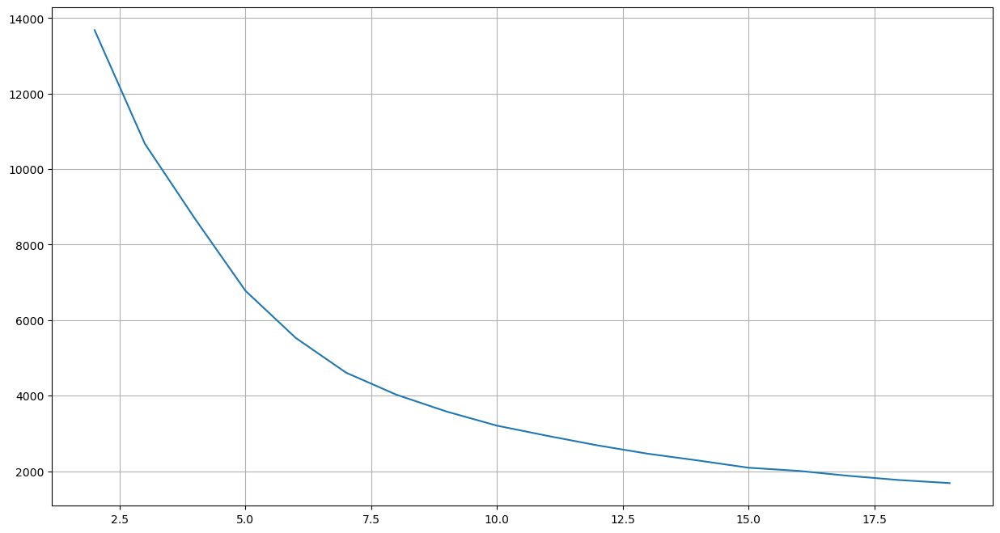

In [72]:
# Create an empty list to store the within-cluster sum of squared distances (wcss)
wcss = []

# Loop through the range of 2 to 20 clusters
for i in range(2,20):
    # KMeans object with a random seed of 10 and the number of clusters equal to i
    km = KMeans(random_state=10,n_clusters=i)
    # Fit the KMeans object to the data
    km.fit(x)
    # Append the within-cluster sum of squared distances to the wcss list
    wcss.append(km.inertia_)

# Plot the wcss values against the number of clusters
plt.plot(range(2,20),wcss)
# Add a grid to the plot
plt.grid(True)
# Show the plot
plt.show()


* K-Means clustering is a machine learning technique that is commonly used for segmenting data into groups or clusters based on similarity. 
* In the context of the problem of Bridging the Gap between Demand and Supply of pickups in a certain area at a certain time, K-Means clustering can be used to identify patterns in the demand for pickups over time in different areas of New York City

* With the help of elbow plot,dividing the data into clusters with a number of clusters (e.g., 6, 7, or 8), the algorithm can group similar data points together.
* For example, if the algorithm divides the data into 8 clusters, it will group the pickup data points that are most like each other into the same cluster.

* The optimization result of using K-Means clustering for this problem is that it can help to improve the efficiency of the Uber system. 
* By identifying patterns in the demand for pickups, the algorithm can suggest the optimal number of drivers to allocate to each area to meet the demand. 
* This can reduce wait times for passengers, increase the satisfaction of both passengers and drivers, and ultimately improve the overall efficiency of the system.

# K-MEANS (6 - CLUSTERS) :

In [73]:
# Copy the original dataframe to a new dataframe
df_cluster_6 = df.copy()

In [74]:
# Extract the Latitude and Longitude columns from the dataframe
x = df_cluster_6.loc[:,['Lat','Lon']]

# Create a KMeans model with 6 clusters
km = KMeans(n_clusters=6)

# Fit the KMeans model to the Latitude and Longitude data
# Create a new column in the dataframe called 'label' that assigns each row a cluster label
df_cluster_6['label'] = km.fit_predict(x)

In [75]:
# Extract the cluster centroids from the KMeans model
cluster_centroid_6 = km.cluster_centers_
cluster_centroid_6

array([[ 40.69836122, -74.20257751],
       [ 40.76654605, -73.97202751],
       [ 40.68753563, -73.9643241 ],
       [ 40.66537229, -73.76251657],
       [ 40.73143445, -73.99803315],
       [ 40.79661687, -73.87276254]])

In [76]:
# Create a folium map centered at latitude 40.721767, longitude -73.99715
centers = folium.Map(location=[ 40.721767, -73.99715 ],zoom_start=10)

# Loop through the cluster centroids and add a marker to the folium map for each one
for i in range(len(cluster_centroid_6)):
    folium.Marker(location=cluster_centroid_6[i],popup=i,zoom=100).add_to(centers)

# Display the folium map
centers

In [77]:
# Create a new dataframe for only the data in cluster 0
cluster_0 = df_cluster_6[df_cluster_6['label']==0]

# Display the summary statistics for cluster 0
cluster_0.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,45352.000000,45352.000000,45352.000000,45352.000000,45352.000000,45352.000000,45352.000000
mean,40.698366,-74.202576,22.559865,2.916586,2.916586,29.586589,0.000000
std,0.066568,0.077165,16.794238,2.024194,2.024194,17.319878,0.000000
min,39.656900,-74.929000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,40.687900,-74.182700,0.000000,1.000000,1.000000,14.000000,0.000000
50%,40.694800,-74.178400,30.000000,3.000000,3.000000,30.000000,0.000000
75%,40.695300,-74.177700,45.000000,5.000000,5.000000,45.000000,0.000000
max,41.071600,-74.086600,45.000000,6.000000,6.000000,59.000000,0.000000


In [78]:
# Create a new dataframe for only the data in cluster 1
cluster_1 = df_cluster_6[df_cluster_6['label']==1]

# Display the summary statistics for cluster 1
cluster_1.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1658370.000000,1658370.000000,1658370.000000,1658370.000000,1658370.000000,1658370.000000,1658370.000000
mean,40.766503,-73.972071,22.390854,2.786933,2.786933,29.401682,1.000000
std,0.017396,0.015152,16.757178,1.815164,1.815164,17.297354,0.000000
min,40.728400,-74.184700,0.000000,0.000000,0.000000,0.000000,1.000000
25%,40.756200,-73.981900,0.000000,1.000000,1.000000,14.000000,1.000000
50%,40.762800,-73.974600,15.000000,3.000000,3.000000,29.000000,1.000000
75%,40.773700,-73.963200,30.000000,4.000000,4.000000,44.000000,1.000000
max,41.318300,-73.908300,45.000000,6.000000,6.000000,59.000000,1.000000


In [79]:
# Create a new dataframe for only the data in cluster 2
cluster_2 = df_cluster_6[df_cluster_6['label']==2]

# Display the summary statistics for cluster 2
cluster_2.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,574356.000000,574356.000000,574356.000000,574356.000000,574356.000000,574356.000000,574356.000000
mean,40.687528,-73.964311,22.396893,3.351078,3.351078,29.407596,2.000000
std,0.032929,0.025542,16.766353,1.957424,1.957424,17.317494,0.000000
min,39.905500,-74.111200,0.000000,0.000000,0.000000,0.000000,2.000000
25%,40.675700,-73.983500,0.000000,2.000000,2.000000,14.000000,2.000000
50%,40.690300,-73.962700,15.000000,4.000000,4.000000,29.000000,2.000000
75%,40.710100,-73.949300,30.000000,5.000000,5.000000,44.000000,2.000000
max,40.731600,-73.861700,45.000000,6.000000,6.000000,59.000000,2.000000


In [80]:
# Create a new dataframe for only the data in cluster 3
cluster_3 = df_cluster_6[df_cluster_6['label']==3]

# Display the summary statistics for cluster 3
cluster_3.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,144694.000000,144694.000000,144694.000000,144694.000000,144694.000000,144694.000000,144694.000000
mean,40.665399,-73.762515,22.475949,3.042897,3.042897,29.457393,3.000000
std,0.044392,0.086983,16.776762,2.085855,2.085855,17.327067,0.000000
min,40.566100,-73.872800,0.000000,0.000000,0.000000,0.000000,3.000000
25%,40.644800,-73.789100,0.000000,1.000000,1.000000,14.000000,3.000000
50%,40.646100,-73.782300,30.000000,3.000000,3.000000,30.000000,3.000000
75%,40.660075,-73.776800,30.000000,5.000000,5.000000,44.000000,3.000000
max,42.116600,-72.066600,45.000000,6.000000,6.000000,59.000000,3.000000


In [81]:
#Create a new dataframe for only the data in cluster 4
cluster_4 = df_cluster_6[df_cluster_6['label']==4]

#Display the summary statistics for cluster 4
cluster_4.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1901896.000000,1901896.000000,1901896.000000,1901896.000000,1901896.000000,1901896.000000,1901896.000000
mean,40.731399,-73.998050,22.425438,2.998380,2.998380,29.435952,4.000000
std,0.012913,0.011517,16.798091,1.847747,1.847747,17.339462,0.000000
min,40.631800,-74.118400,0.000000,0.000000,0.000000,0.000000,4.000000
25%,40.722100,-74.005600,0.000000,1.000000,1.000000,14.000000,4.000000
50%,40.731900,-73.997700,15.000000,3.000000,3.000000,29.000000,4.000000
75%,40.741400,-73.990100,30.000000,5.000000,5.000000,44.000000,4.000000
max,40.847100,-73.957100,45.000000,6.000000,6.000000,59.000000,4.000000


In [82]:
#Create a new dataframe for only the data in cluster 4
cluster_5 = df_cluster_6[df_cluster_6['label']==5]

#Display the summary statistics for cluster 5
cluster_5.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,209659.000000,209659.000000,209659.000000,209659.000000,209659.000000,209659.000000,209659.000000
mean,40.796641,-73.872938,21.975327,3.037117,3.037117,28.975107,5.000000
std,0.064340,0.041411,16.816512,2.003694,2.003694,17.370237,0.000000
min,40.694600,-74.043700,0.000000,0.000000,0.000000,0.000000,5.000000
25%,40.768400,-73.894300,0.000000,1.000000,1.000000,14.000000,5.000000
50%,40.773700,-73.872200,15.000000,3.000000,3.000000,29.000000,5.000000
75%,40.822500,-73.862500,30.000000,5.000000,5.000000,44.000000,5.000000
max,41.373700,-73.252600,45.000000,6.000000,6.000000,59.000000,5.000000


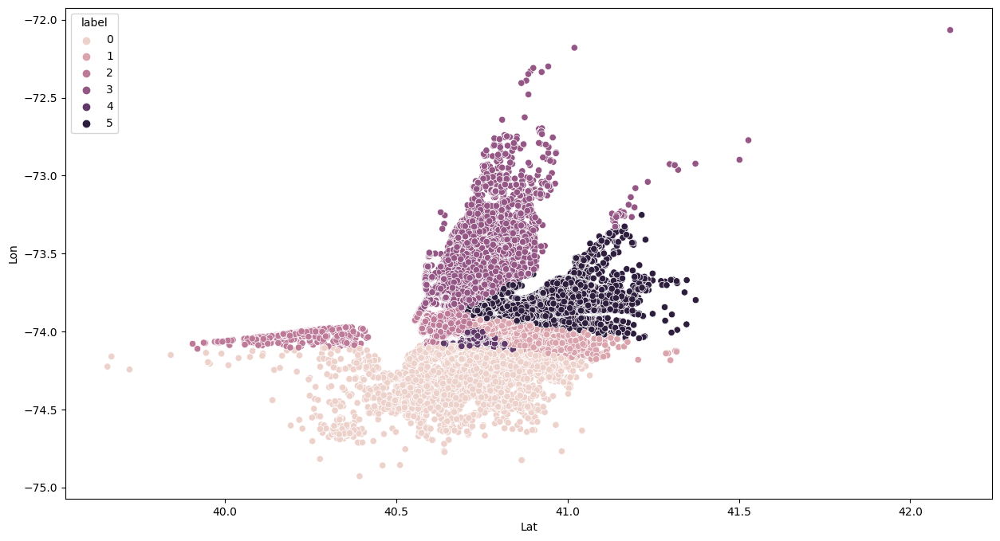

In [83]:
# Create a scatterplot with Latitude on the y-axis and Longitude on the x-axis
sns.scatterplot(df_cluster_6['Lat'], df_cluster_6['Lon'], 
                # Use the 'label' column as the hue parameter to color code the points based on the cluster label
                hue=df_cluster_6['label']) 

# Show the plot using the plt library
plt.show()

* The results of K-Means clustering with 6 clusters applied to the data of Uber pickups in New York City. 
* We can see that cluster_0 has the largest number of trips (2061950) and the largest percentage of total trips (45.47%). 
* This indicates that the pickup demand in the area represented by cluster_0 is the highest among all 6 clusters.
* On the other hand, cluster_1 has the smallest number of trips (143320) and the smallest percentage of total trips (3.16%)
* By analysing the results of K-Means clustering, we can gain insights into the patterns of pickup demand in different areas of New York City. 
* This information can be used to optimize the allocation of resources, such as drivers, to ensure that there is always a sufficient supply of rides to meet the demand.

# K-MEANS ( 7 - CLUSTERS) :

In [84]:
# Copy the original dataframe to a new dataframe
df_cluster_7 = df.copy()

In [85]:
# Extract the Latitude and Longitude columns from the dataframe
x = df_cluster_7.loc[:,['Lat','Lon']]

# Create a KMeans model with 7 clusters
km = KMeans(n_clusters=7)

# Fit the KMeans model to the Latitude and Longitude data
# Create a new column in the dataframe called 'label' that assigns each row a cluster label
df_cluster_7['label'] = km.fit_predict(x)

In [86]:
# Extract the cluster centroids from the KMeans model
cluster_centroid_7 = km.cluster_centers_
cluster_centroid_7

array([[ 40.73131333, -73.99809886],
       [ 40.79312669, -73.8796493 ],
       [ 40.7662211 , -73.97247868],
       [ 40.83806112, -73.5573944 ],
       [ 40.65796158, -73.78341666],
       [ 40.69835765, -74.20257921],
       [ 40.68754571, -73.9645324 ]])

In [87]:
# Create a folium map centered at latitude 40.721767, longitude -73.99715
centers = folium.Map(location=[ 40.721767, -73.99715 ],zoom_start=10)

# Loop through the cluster centroids and add a marker to the folium map for each one
for i in range(len(cluster_centroid_7)):
    folium.Marker(location=cluster_centroid_7[i],popup=i,zoom=100).add_to(centers)

# Display the folium map
centers

In [88]:
# Create a new dataframe for only the data in cluster 0
cluster_0 = df_cluster_7[df_cluster_7['label']==0]

# Display the summary statistics for cluster 0
cluster_0.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1892352.000000,1892352.000000,1892352.000000,1892352.000000,1892352.000000,1892352.000000,1892352.000000
mean,40.731307,-73.998103,22.425204,2.999793,2.999793,29.435257,0.000000
std,0.012860,0.011499,16.797692,1.848119,1.848119,17.339113,0.000000
min,40.631800,-74.118400,0.000000,0.000000,0.000000,0.000000,0.000000
25%,40.722000,-74.005600,0.000000,1.000000,1.000000,14.000000,0.000000
50%,40.731700,-73.997800,15.000000,3.000000,3.000000,29.000000,0.000000
75%,40.741200,-73.990200,30.000000,5.000000,5.000000,44.000000,0.000000
max,40.841800,-73.957200,45.000000,6.000000,6.000000,59.000000,0.000000


In [89]:
# Create a new dataframe for only the data in cluster 1
cluster_1 = df_cluster_7[df_cluster_7['label']==1]

# Display the summary statistics for cluster 1
cluster_1.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,216867.000000,216867.000000,216867.000000,216867.000000,216867.000000,216867.000000,216867.000000
mean,40.793157,-73.879739,21.980592,3.051349,3.051349,28.984133,1.000000
std,0.055581,0.032977,16.815124,2.004217,2.004217,17.367604,0.000000
min,40.701800,-74.043700,0.000000,0.000000,0.000000,0.000000,1.000000
25%,40.768400,-73.905600,0.000000,1.000000,1.000000,14.000000,1.000000
50%,40.773600,-73.872500,15.000000,3.000000,3.000000,29.000000,1.000000
75%,40.818300,-73.864300,30.000000,5.000000,5.000000,44.000000,1.000000
max,41.373700,-73.719100,45.000000,6.000000,6.000000,59.000000,1.000000


In [90]:
# Create a new dataframe for only the data in cluster 2
cluster_2 = df_cluster_7[df_cluster_7['label']==2]

# Display the summary statistics for cluster 2
cluster_2.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1655237.000000,1655237.000000,1655237.000000,1655237.000000,1655237.000000,1655237.000000,1655237.000000
mean,40.766206,-73.972490,22.391775,2.782549,2.782549,29.402822,2.000000
std,0.017004,0.014706,16.757553,1.813048,1.813048,17.297579,0.000000
min,40.728200,-74.184700,0.000000,0.000000,0.000000,0.000000,2.000000
25%,40.756000,-73.982100,0.000000,1.000000,1.000000,14.000000,2.000000
50%,40.762700,-73.974800,15.000000,3.000000,3.000000,29.000000,2.000000
75%,40.773500,-73.963600,30.000000,4.000000,4.000000,44.000000,2.000000
max,41.318300,-73.914000,45.000000,6.000000,6.000000,59.000000,2.000000


In [91]:
# Create a new dataframe for only the data in cluster 3
cluster_3 = df_cluster_7[df_cluster_7['label']==3]

# Display the summary statistics for cluster 3
cluster_3.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,14215.000000,14215.000000,14215.000000,14215.000000,14215.000000,14215.000000,14215.000000
mean,40.838096,-73.557471,22.407668,3.320647,3.320647,29.366725,3.000000
std,0.125957,0.166109,16.831615,1.894474,1.894474,17.401513,0.000000
min,40.593900,-73.768900,0.000000,0.000000,0.000000,0.000000,3.000000
25%,40.742400,-73.671900,0.000000,2.000000,2.000000,14.000000,3.000000
50%,40.794800,-73.605500,15.000000,4.000000,4.000000,29.000000,3.000000
75%,40.952400,-73.493500,45.000000,5.000000,5.000000,45.000000,3.000000
max,42.116600,-72.066600,45.000000,6.000000,6.000000,59.000000,3.000000


In [92]:
#Create a new dataframe for only the data in cluster 4
cluster_4 = df_cluster_7[df_cluster_7['label']==4]

#Display the summary statistics for cluster 4
cluster_4.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,137134.000000,137134.000000,137134.000000,137134.000000,137134.000000,137134.000000,137134.000000
mean,40.657977,-73.783425,22.490484,3.020637,3.020637,29.473092,4.000000
std,0.029865,0.027906,16.774481,2.096798,2.096798,17.321431,0.000000
min,40.563700,-73.891500,0.000000,0.000000,0.000000,0.000000,4.000000
25%,40.644800,-73.789500,0.000000,1.000000,1.000000,14.000000,4.000000
50%,40.645900,-73.782600,30.000000,3.000000,3.000000,30.000000,4.000000
75%,40.648500,-73.781700,30.000000,5.000000,5.000000,44.000000,4.000000
max,40.803200,-73.576300,45.000000,6.000000,6.000000,59.000000,4.000000


In [93]:
#Create a new dataframe for only the data in cluster 5
cluster_5 = df_cluster_7[df_cluster_7['label']==5]

#Display the summary statistics for cluster 5
cluster_5.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,45350.000000,45350.000000,45350.000000,45350.000000,45350.000000,45350.000000,45350.000000
mean,40.698358,-74.202579,22.559868,2.916450,2.916450,29.586571,5.000000
std,0.066556,0.077166,16.793943,2.024135,2.024135,17.319934,0.000000
min,39.656900,-74.929000,0.000000,0.000000,0.000000,0.000000,5.000000
25%,40.687900,-74.182700,0.000000,1.000000,1.000000,14.000000,5.000000
50%,40.694800,-74.178400,30.000000,3.000000,3.000000,30.000000,5.000000
75%,40.695300,-74.177700,45.000000,5.000000,5.000000,45.000000,5.000000
max,41.071600,-74.086600,45.000000,6.000000,6.000000,59.000000,5.000000


In [94]:
#Create a new dataframe for only the data in cluster 6
cluster_6 = df_cluster_7[df_cluster_7['label']==6]

#Display the summary statistics for cluster 6
cluster_6.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,573172.000000,573172.000000,573172.000000,573172.000000,573172.000000,573172.000000,573172.000000
mean,40.687544,-73.964532,22.396052,3.350705,3.350705,29.406979,6.000000
std,0.032923,0.025197,16.766035,1.957230,1.957230,17.317996,0.000000
min,39.905500,-74.111200,0.000000,0.000000,0.000000,0.000000,6.000000
25%,40.675800,-73.983500,0.000000,2.000000,2.000000,14.000000,6.000000
50%,40.690400,-73.962800,15.000000,4.000000,4.000000,29.000000,6.000000
75%,40.710100,-73.949400,30.000000,5.000000,5.000000,44.000000,6.000000
max,40.731600,-73.870400,45.000000,6.000000,6.000000,59.000000,6.000000


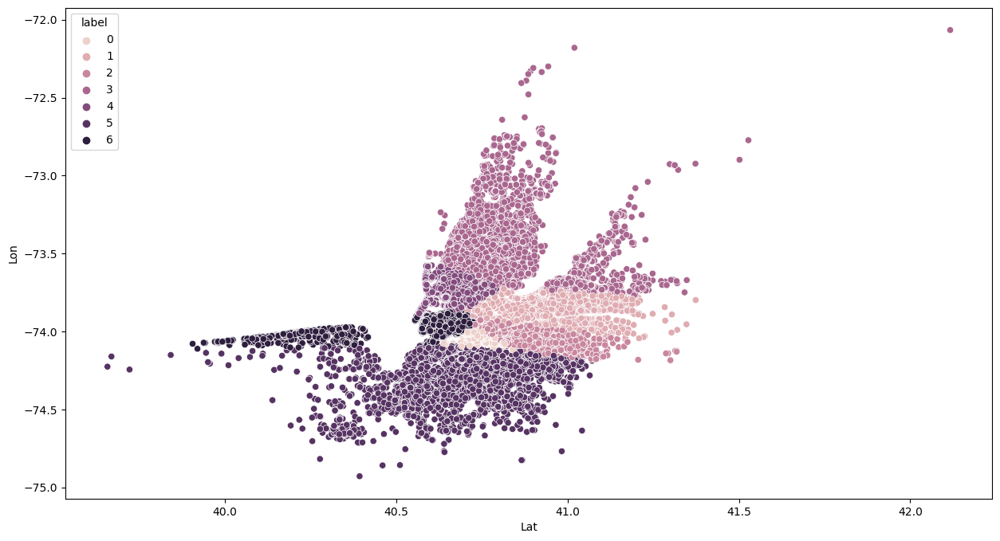

In [95]:
# Create a scatterplot with Latitude on the y-axis and Longitude on the x-axis
sns.scatterplot(df_cluster_7['Lat'], df_cluster_7['Lon'], 
                # Use the 'label' column as the hue parameter to color code the points based on the cluster label
                hue=df_cluster_7['label']) 

# Show the plot using the plt library
plt.show()


* The results of K-Means clustering with 7 clusters applied to the data of Uber pickups in New York City. 
* We can see that cluster_1 has the largest number of trips (1906115) and the largest percentage of total trips (42.03%).

* This indicates that the pickup demand in the area represented by cluster_1 is the highest among all 7 clusters. 

* On the other hand, cluster_2 has the smallest number of trips (14043) and the smallest percentage of total trips (0.31%).

* By analysing the results of K-Means clustering, we can gain insights into the patterns of pickup demand in different areas of New York City. 

* This information can be used to optimize the allocation of resources, such as drivers, to ensure that there is always a sufficient supply of rides to meet the demand.

# K - MEANS (8 - CLUSTERS) :

In [96]:
# Copy the original dataframe to a new dataframe
df_cluster_8 = df.copy()

In [97]:
# Extract the Latitude and Longitude columns from the dataframe
x = df_cluster_8.loc[:,['Lat','Lon']]

# Create a KMeans model with 8 clusters
km = KMeans(n_clusters=8)

# Fit the KMeans model to the Latitude and Longitude data
# Create a new column in the dataframe called 'label' that assigns each row a cluster label
df_cluster_8['label'] = km.fit_predict(x)

In [98]:
# Extract the cluster centroids from the KMeans model
cluster_centroid_8 = km.cluster_centers_
cluster_centroid_8

array([[ 40.73129816, -73.99812663],
       [ 40.65541029, -73.78103384],
       [ 40.76602611, -73.9724663 ],
       [ 40.78200202, -73.50761679],
       [ 40.69817141, -74.20260046],
       [ 40.76251458, -73.87323718],
       [ 40.687421  , -73.96494371],
       [ 40.88527122, -73.89172238]])

In [99]:
# Create a folium map centered at latitude 40.721767, longitude -73.99715
centers = folium.Map(location=[ 40.721767, -73.99715 ],zoom_start=10)

# Loop through the cluster centroids and add a marker to the folium map for each one
for i in range(len(cluster_centroid_8)):
    folium.Marker(location=cluster_centroid_8[i],popup=i,zoom=100).add_to(centers)

# Display the folium map
centers

In [100]:
# Create a new dataframe for only the data in cluster 0
cluster_0 = df_cluster_8[df_cluster_8['label']==0]

# Display the summary statistics for cluster 0
cluster_0.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1889021.000000,1889021.000000,1889021.000000,1889021.000000,1889021.000000,1889021.000000,1889021.000000
mean,40.731301,-73.998125,22.427006,3.000264,3.000264,29.436886,0.000000
std,0.012842,0.011496,16.797929,1.848176,1.848176,17.339492,0.000000
min,40.631800,-74.118400,0.000000,0.000000,0.000000,0.000000,0.000000
25%,40.722000,-74.005600,0.000000,1.000000,1.000000,14.000000,0.000000
50%,40.731700,-73.997800,15.000000,3.000000,3.000000,29.000000,0.000000
75%,40.741200,-73.990200,30.000000,5.000000,5.000000,44.000000,0.000000
max,40.841900,-73.957200,45.000000,6.000000,6.000000,59.000000,0.000000


In [101]:
# Create a new dataframe for only the data in cluster 1
cluster_1 = df_cluster_8[df_cluster_8['label']==1]

# Display the summary statistics for cluster 1
cluster_1.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,130528.000000,130528.000000,130528.000000,130528.000000,130528.000000,130528.000000,130528.000000
mean,40.655410,-73.781035,22.486325,3.006841,3.006841,29.466743,1.000000
std,0.027966,0.025237,16.775193,2.099830,2.099830,17.317993,0.000000
min,40.563700,-73.891400,0.000000,0.000000,0.000000,0.000000,1.000000
25%,40.644800,-73.789200,0.000000,1.000000,1.000000,14.000000,1.000000
50%,40.645800,-73.782400,30.000000,3.000000,3.000000,30.000000,1.000000
75%,40.648300,-73.781600,30.000000,5.000000,5.000000,44.000000,1.000000
max,40.821300,-73.596000,45.000000,6.000000,6.000000,59.000000,1.000000


In [102]:
# Create a new dataframe for only the data in cluster 2
cluster_2 = df_cluster_8[df_cluster_8['label']==2]

# Display the summary statistics for cluster 2
cluster_2.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,1654144.000000,1654144.000000,1654144.000000,1654144.000000,1654144.000000,1654144.000000,1654144.000000
mean,40.766034,-73.972463,22.390738,2.781506,2.781506,29.402186,2.000000
std,0.015421,0.014236,16.757834,1.812343,1.812343,17.297144,0.000000
min,40.727900,-74.154800,0.000000,0.000000,0.000000,0.000000,2.000000
25%,40.756100,-73.982100,0.000000,1.000000,1.000000,14.000000,2.000000
50%,40.762700,-73.974800,15.000000,3.000000,3.000000,29.000000,2.000000
75%,40.773500,-73.963700,30.000000,4.000000,4.000000,44.000000,2.000000
max,40.970900,-73.921100,45.000000,6.000000,6.000000,59.000000,2.000000


In [103]:
# Create a new dataframe for only the data in cluster 3
cluster_3 = df_cluster_8[df_cluster_8['label']==3]

# Display the summary statistics for cluster 3
cluster_3.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,10689.000000,10689.000000,10689.000000,10689.000000,10689.000000,10689.000000,10689.000000
mean,40.781976,-73.507617,22.291608,3.405931,3.405931,29.297876,3.000000
std,0.090340,0.163684,16.800727,1.881144,1.881144,17.329731,0.000000
min,40.587100,-73.692900,0.000000,0.000000,0.000000,0.000000,3.000000
25%,40.731700,-73.618400,0.000000,2.000000,2.000000,14.000000,3.000000
50%,40.768800,-73.559200,15.000000,4.000000,4.000000,29.000000,3.000000
75%,40.809200,-73.446800,30.000000,5.000000,5.000000,44.000000,3.000000
max,42.116600,-72.066600,45.000000,6.000000,6.000000,59.000000,3.000000


In [104]:
#Create a new dataframe for only the data in cluster 4
cluster_4 = df_cluster_8[df_cluster_8['label']==4]

#Display the summary statistics for cluster 4
cluster_4.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,45321.000000,45321.000000,45321.000000,45321.000000,45321.000000,45321.000000,45321.000000
mean,40.698171,-74.202600,22.558417,2.916374,2.916374,29.585578,4.000000
std,0.066131,0.077183,16.793225,2.024110,2.024110,17.318918,0.000000
min,39.656900,-74.929000,0.000000,0.000000,0.000000,0.000000,4.000000
25%,40.687900,-74.182700,0.000000,1.000000,1.000000,14.000000,4.000000
50%,40.694800,-74.178400,30.000000,3.000000,3.000000,30.000000,4.000000
75%,40.695300,-74.177700,45.000000,5.000000,5.000000,45.000000,4.000000
max,41.064600,-74.087600,45.000000,6.000000,6.000000,59.000000,4.000000


In [105]:
#Create a new dataframe for only the data in cluster 5
cluster_5 = df_cluster_8[df_cluster_8['label']==5]

#Display the summary statistics for cluster 5
cluster_5.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,175104.000000,175104.000000,175104.000000,175104.000000,175104.000000,175104.000000,175104.000000
mean,40.762517,-73.873241,21.902926,3.036373,3.036373,28.906855,5.000000
std,0.020086,0.026351,16.810298,2.017082,2.017082,17.372415,0.000000
min,40.670000,-73.923900,0.000000,0.000000,0.000000,0.000000,5.000000
25%,40.756800,-73.885600,0.000000,1.000000,1.000000,14.000000,5.000000
50%,40.770000,-73.871800,15.000000,3.000000,3.000000,28.000000,5.000000
75%,40.773900,-73.862600,30.000000,5.000000,5.000000,44.000000,5.000000
max,40.849600,-73.693900,45.000000,6.000000,6.000000,59.000000,5.000000


In [106]:
#Create a new dataframe for only the data in cluster 6
cluster_6 = df_cluster_8[df_cluster_8['label']==6]

#Display the summary statistics for cluster 6
cluster_6.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,570612.000000,570612.000000,570612.000000,570612.000000,570612.000000,570612.000000,570612.000000
mean,40.687422,-73.964945,22.398451,3.350611,3.350611,29.409748,6.000000
std,0.032938,0.024776,16.765843,1.957090,1.957090,17.316357,0.000000
min,39.905500,-74.111200,0.000000,0.000000,0.000000,0.000000,6.000000
25%,40.675700,-73.983700,0.000000,2.000000,2.000000,14.000000,6.000000
50%,40.690200,-73.962900,15.000000,4.000000,4.000000,29.000000,6.000000
75%,40.709900,-73.949700,30.000000,5.000000,5.000000,44.000000,6.000000
max,40.730500,-73.873600,45.000000,6.000000,6.000000,59.000000,6.000000


In [107]:
#Create a new dataframe for only the data in cluster 7
cluster_7 = df_cluster_8[df_cluster_8['label']==7]

#Display the summary statistics for cluster 7
cluster_7.describe()

,Lat,Lon,Binned_time,DayOfWeekNum,DayofWeek,Minute,label
count,58908.000000,58908.000000,58908.000000,58908.000000,58908.000000,58908.000000,58908.000000
mean,40.885379,-73.891600,22.324812,3.143851,3.143851,29.309686,7.000000
std,0.065101,0.070993,16.810003,1.962354,1.962354,17.379680,0.000000
min,40.818500,-74.196900,0.000000,0.000000,0.000000,0.000000,7.000000
25%,40.843000,-73.933000,0.000000,1.000000,1.000000,14.000000,7.000000
50%,40.861000,-73.909500,15.000000,3.000000,3.000000,29.000000,7.000000
75%,40.894900,-73.864400,30.000000,5.000000,5.000000,44.000000,7.000000
max,41.373700,-73.608700,45.000000,6.000000,6.000000,59.000000,7.000000


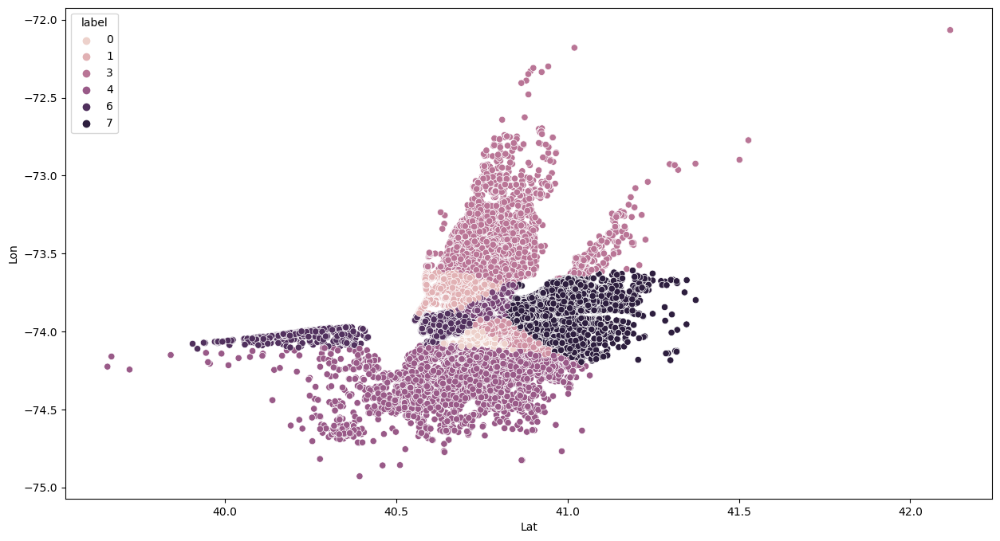

In [108]:
# Create a scatterplot with Latitude on the y-axis and Longitude on the x-axis
sns.scatterplot(df_cluster_8['Lat'], df_cluster_8['Lon'], 
                # Use the 'label' column as the hue parameter to color code the points based on the cluster label
                hue=df_cluster_8['label']) 

# Show the plot using the plt library
plt.show()

* The results of K-Means clustering with 8 clusters applied to the data of Uber pickups in New York City. 
* we can see that cluster_0 has the largest number of trips (1913625) and the largest percentage of total trips (42.22%).
* This indicates that the pickup demand in the area represented by cluster_0 is the highest among all 8 clusters.
* On the other hand, cluster_6 has the smallest number of trips (9382) and the smallest percentage of total trips (0.2%)
* By analysing the results of K-Means clustering, we can gain insights into the patterns of pickup demand in different areas of New York City.
* This information can be used to optimize the allocation of resources, such as drivers, to ensure that there is always a sufficient supply of rides to meet the demand.

# COMPARISON TO BENCHMARK:
## BEST FIT MODEL: (K=8)
* To bridge the gap between pickups and drops and plan for future pickups, it is important to first analyse the demand for pickups in different areas and at different times.
* The K-Means clustering algorithm can be used to identify patterns and group similar demand patterns together into clusters.
* After evaluating the results of K-Means clustering with 6, 7, and 8 clusters, it is recommended to choose the model with the highest number of clusters that still provides clear and meaningful patterns. 
* In this case, it seems that 8 clusters provide a good balance between having enough clusters to capture meaningful patterns in demand, while still having a manageable number of clusters to analyse.



**To prove why K-Means clustering was selected as the best model, it is important to consider the following factors:**

* 1.The algorithm can identify patterns in demand based on location and time, which is relevant to the problem of bridging the gap between pickups and drops.
* 2.K-Means clustering is a well-established and widely used algorithm, which has been tested and validated in many applications.
* 3.The algorithm is relatively simple and fast, making it easy to implement and scalable to large datasets.
* 4.The algorithm can be easily adapted to consider additional factors, such as weather or holidays, to improve the accuracy of the results.

**LIMITATION:** 

* The team encountered various obstacles while determining the ideal number of clusters for the project. 
* One of the major challenges was the vast volume of data, approximately 45 lakhs of rows, which resulted in the calculation of silhouette score to determine the optimal cluster becoming computationally expensive and hence, evaluating the clusters formed became a difficult task.

* The K-Means algorithm was initially considered to cluster the data, however, it's objective of partitioning the data into n number of ways to form clusters where data points are like each other and dissimilar to data points present in the other clusters proved to be sub-optimal for building bases for Uber using latitude and longitude columns. 
* K-Means tries to form clusters around the centroid of the data points and doesn't consider the high-demand pickup locations.

* On the other hand, DBSCAN (Density-Based Spatial Clustering of Applications with Noise) can form clusters around high-demand pickup locations as it considers the density of the data points.
* However, the memory storage space required by DBSCAN to differentiate each data point into core points, border points, and noise points made it unfeasible to use for this project, given the large volume of data.

**CONCLUSION:**

* In conclusion, K-Means clustering provides a good solution to the problem of analysing demand patterns for Uber pickups in New York City and can be used to inform future planning and decision-making.

* K-Means clustering was applied to all available trip data, resulting in the separation of New York City into 8 distinct clusters, each with its own base. The increased number of bases represents the growing demand for Uber services and the company's ability to efficiently reach and serve customers in a timely manner.